# Covid-19 : Advance Machine Learning Classification

---


## Definition

### Abstract 
In this paper use of the state of the art image classifier that is Convolution Neural Network (CNN) to classifier images of Covid - 19, Pneumonia and Normal patients chest X-Ray.

### Introduction   
X-rays can be used to identify various diseases. However, a diagnosis depends on a doctor's experience, which can lead to improper treatment. Thus modern methods of artificial intelligence and pattern recognition make it possible to create expert systems that allow you to establish a diagnosis automatically.
Two different approaches to the classification of images (diseases) will be shown:

  1.  Different classical methods and their comparison
  2.  Convolutional Neural Networks.

Among the different types of neural networks (others include recurrent neural networks (RNN), long short term memory (LSTM), artificial neural networks (ANN), etc.), CNNs are easily the most popular.

These convolutional neural network models are ubiquitous in the image data space. They work phenomenally well on computer vision tasks like image classification, object detection, image recognition, etc.



## Download and preliminary transformation of images
### Import Libraries
Packages used iclude: Mahotas package for image processing and Keras library for creating our CNN model and its training, Matplotlib and Seaborn for visualizing our dataset to gain a better understanding of the images we are going to handle, os and glob to work with files and folders. NumPy will be applied for arrays of images and Scikit-Learn used for classical classification models. And we will take Pandas for present comparison of classifier

In [ ]:
!pip install mahotas
import mahotas as mh
import seaborn as sns
from matplotlib import pyplot as plt 
from glob import glob
import os
import numpy as np
import pandas as pd

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler 

#Classifiers
from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import plot_confusion_matrix

     |████████████████████████████████| 5.7 MB 17.8 MB/s 


### Loading Data and Data Visualisation

Images have to be of the same size for classification. In order to achieve this, let's create a global variable that will determine the size (height and width) for image resizing. Both are 224 in our case.

In [ ]:
IMM_SIZE = 224

In [ ]:
def get_data(folder):
    class_names = [f for f in os.listdir(folder) if not f.startswith('.')] # create a list of SubFolders
    data = []
    print(class_names)
    for t, f in enumerate(class_names):
        images = glob(folder + "/" + f + "/*") # create a list of files
        print("Downloading: ", f)
        fig = plt.figure(figsize = (50,50)) 
        for im_n, im in enumerate(images):
            plt.gray() # set grey colormap of images
            image = mh.imread(im)
            if len(image.shape) > 2:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE, image.shape[2]]) # resize of RGB and png images
            else:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE]) # resize of grey images    
            if len(image.shape) > 2:
                image = mh.colors.rgb2grey(image[:,:,:3], dtype = np.uint8)  # change of colormap of images alpha chanel delete
            plt.subplot(int(len(images)/5)+1,5,im_n+1) # create a table of images
            plt.imshow(image)
            data.append([image, f])
        plt.show()

    return np.array(data)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


['Covid', 'Viral Pneumonia', 'Normal']
Downloading:  Covid


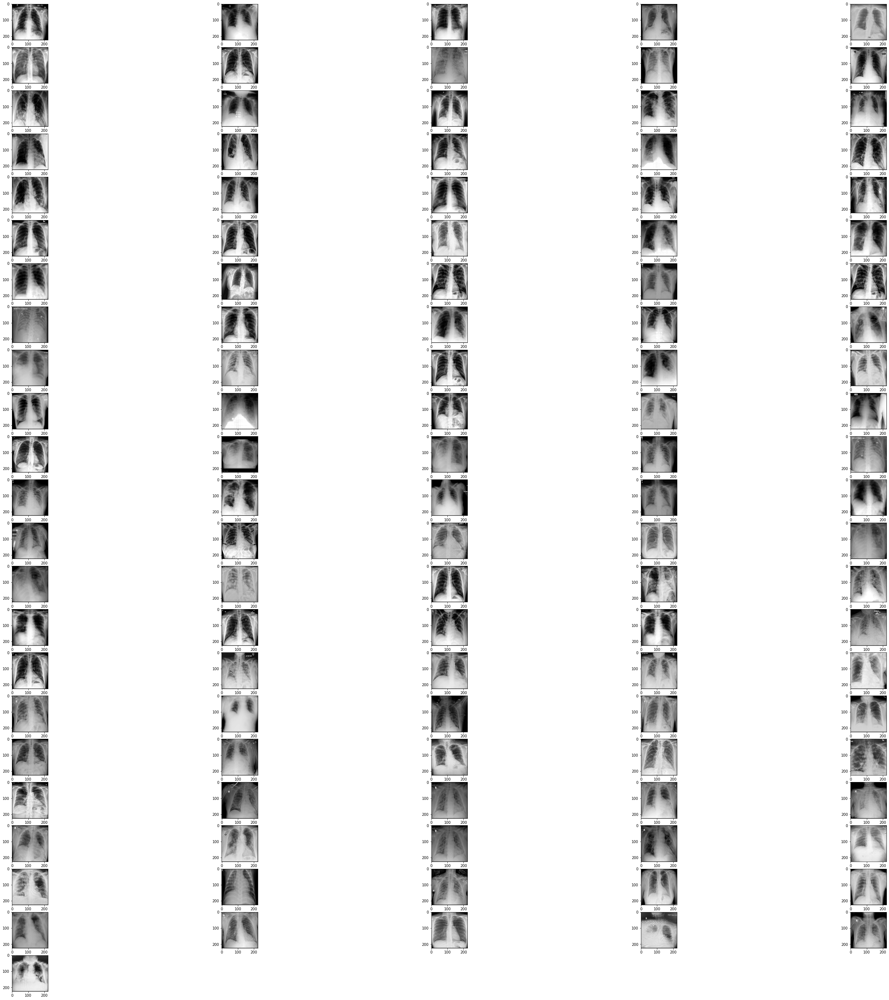

Downloading:  Viral Pneumonia


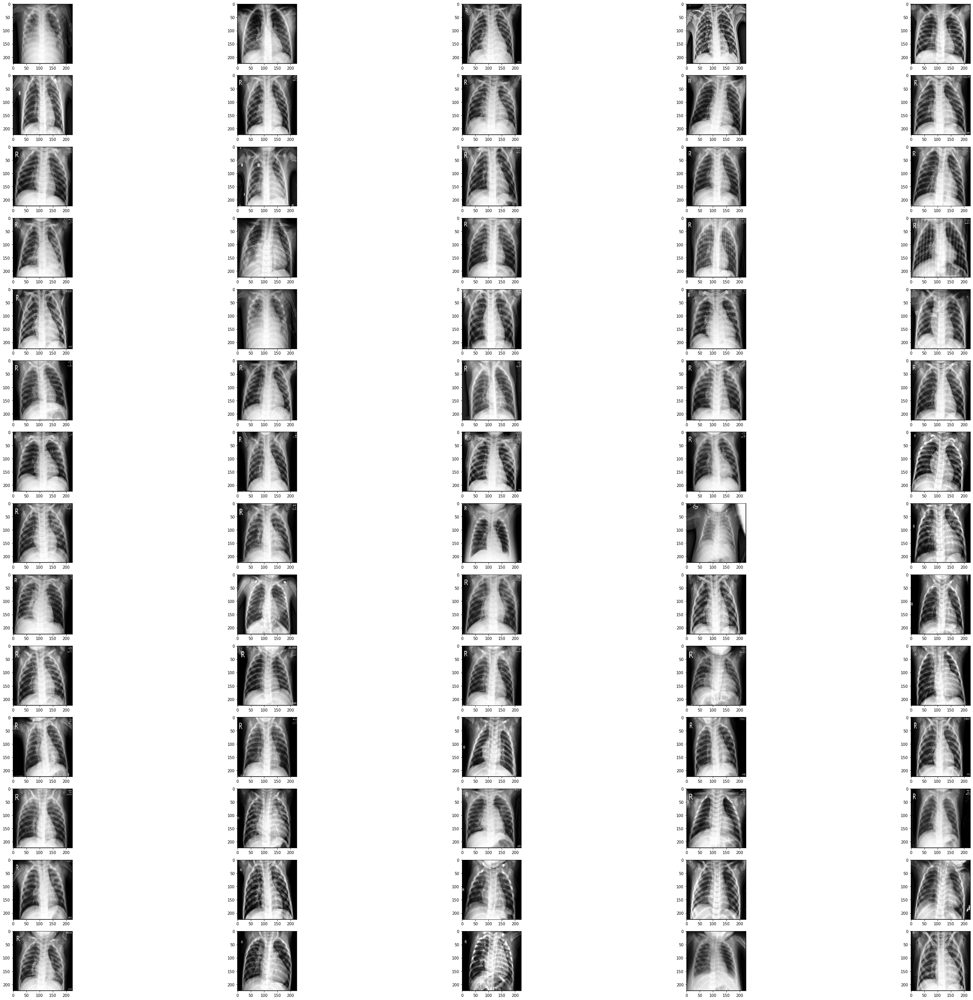

Downloading:  Normal


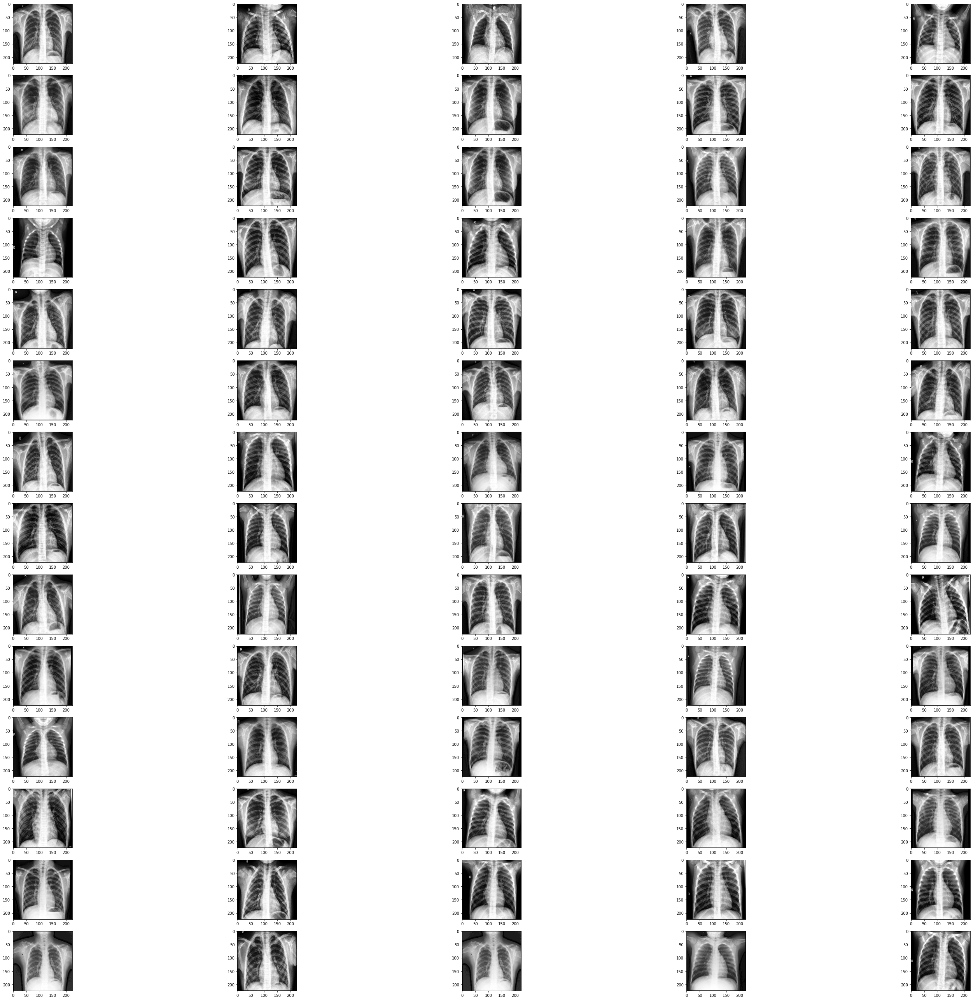

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


['Normal', 'Viral Pneumonia', 'Covid']
Downloading:  Normal


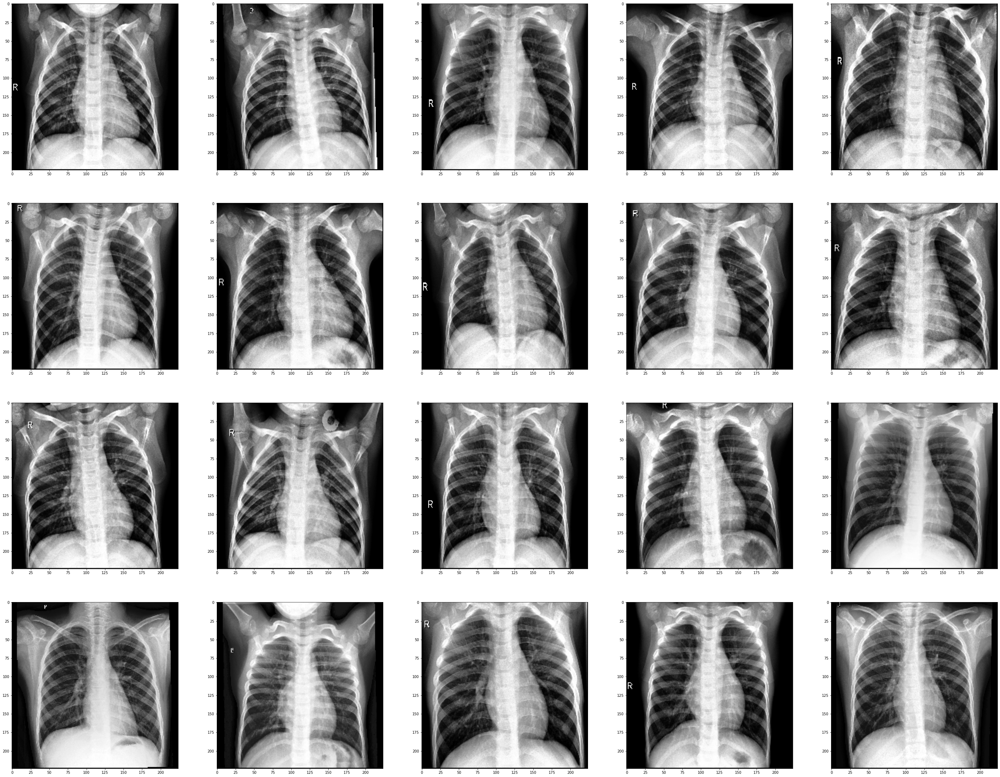

Downloading:  Viral Pneumonia


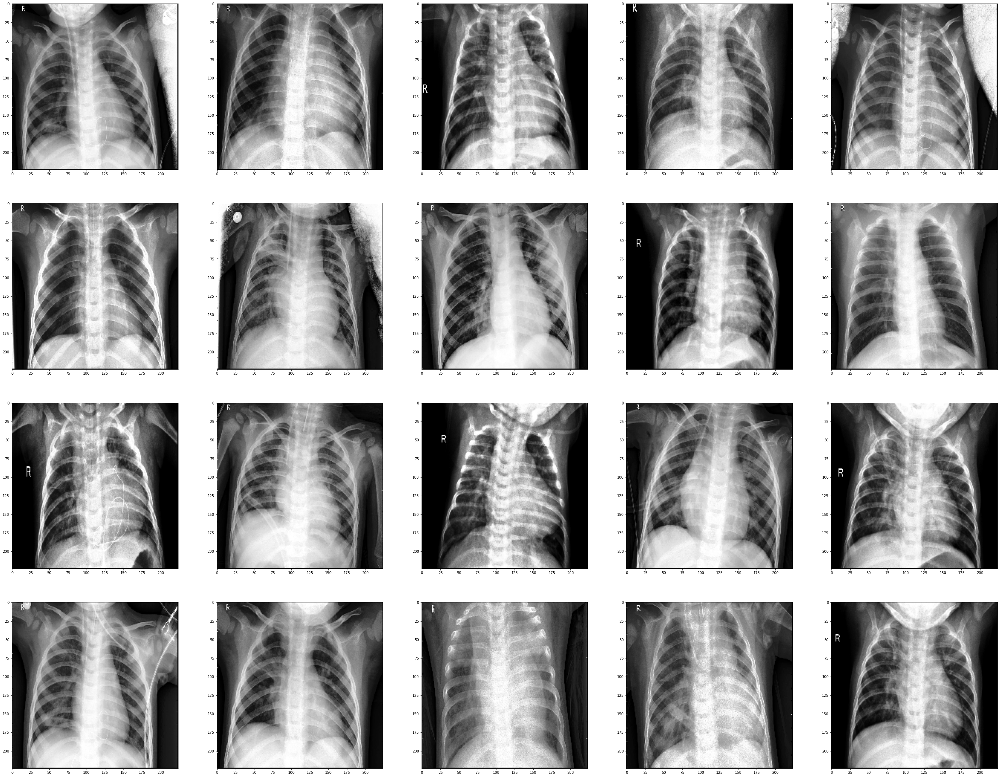

Downloading:  Covid


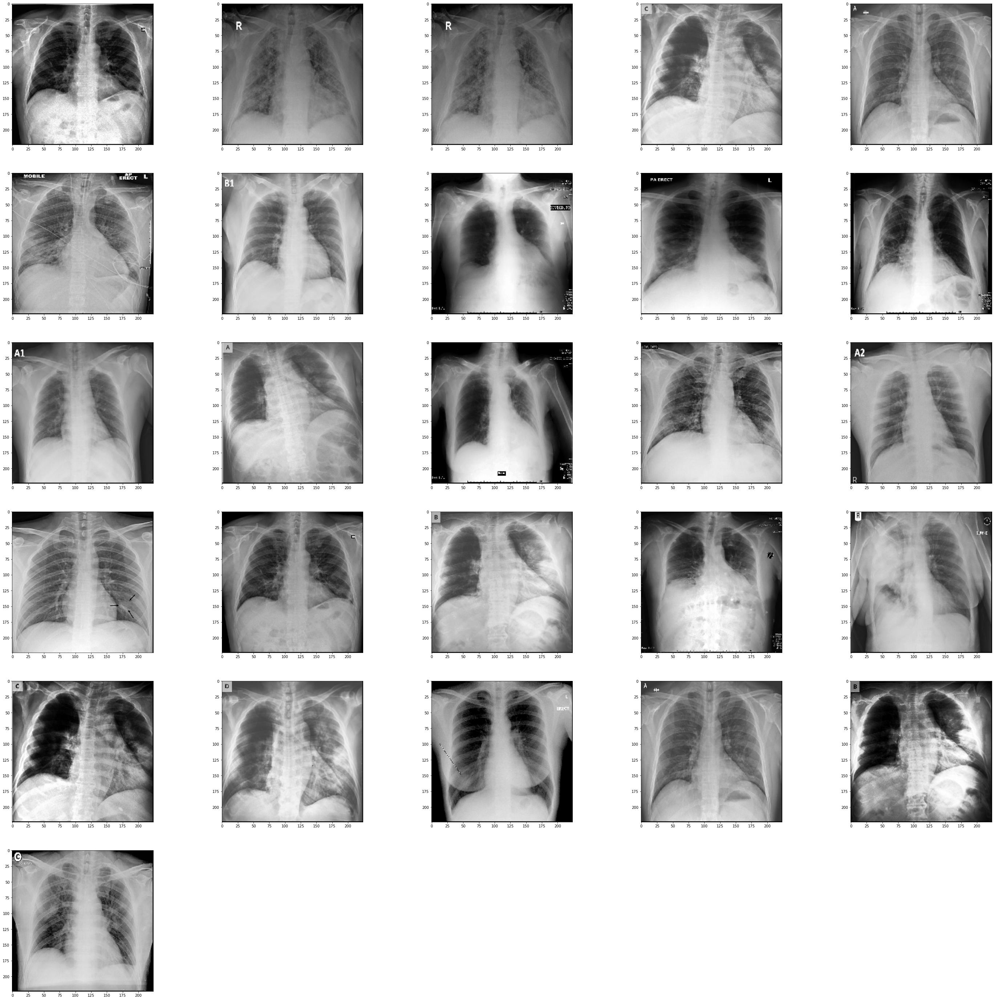

In [ ]:
d = "/content/drive/MyDrive/Machine Learning/Covid19-dataset/train"
train = get_data(d)

d = "/content/drive/MyDrive/Machine Learning/Covid19-dataset/test"
val = get_data(d)

In [ ]:
print("Train shape", train.shape) # Size of the training DataSet
print("Test shape", val.shape) # Size of the test DataSet
print("Image size", train[0][0].shape) # Size of image

Train shape (251, 2)
Test shape (66, 2)
Image size (224, 224)


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


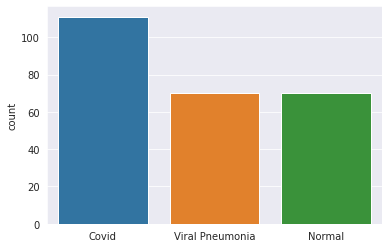

In [ ]:
l = []
for i in train:
    l.append(i[1])
sns.set_style('darkgrid')
sns.countplot(l)

Let us also visualize the first image from the Viral Pneumonia and Covid classes in the training DataSet:


Text(0.5, 1.0, 'Viral Pneumonia')

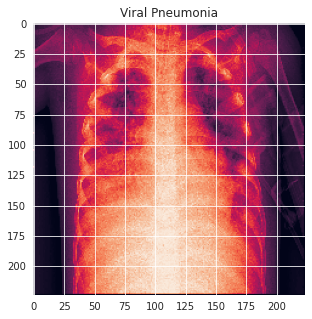

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Viral Pneumonia')[0][0]][0])
plt.title('Viral Pneumonia')

Text(0.5, 1.0, 'Covid')

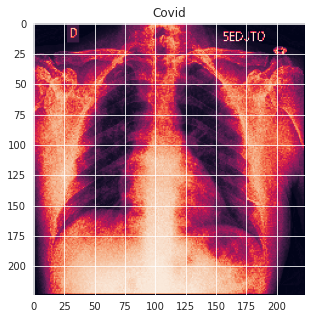

In [ ]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Covid')[0][0]][0])
plt.title('Covid')

## Image features creation

In [ ]:
def create_features(data):
    features = []
    labels = []
    for image, label in data:
        features.append(mh.features.haralick(image).ravel())
        labels.append(label)
    features = np.array(features)
    labels = np.array(labels)
    return (features, labels) 

In [ ]:
features_train, labels_train = create_features(train)
features_test, labels_test = create_features(val)

## Comparing different classical classification methods
LogisticRegression as one classifiers is used to test how classification works

Training DataSet accuracy:  89.6% Test DataSet accuracy:  84.8%


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


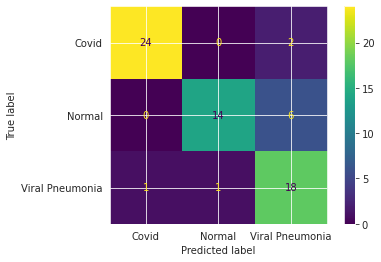

In [ ]:
clf = Pipeline([('preproc', StandardScaler()), ('classifier', LogisticRegression())])
clf.fit(features_train, labels_train)
scores_train = clf.score(features_train, labels_train)
scores_test = clf.score(features_test, labels_test)
print('Training DataSet accuracy: {: .1%}'.format(scores_train), 'Test DataSet accuracy: {: .1%}'.format(scores_test))
plot_confusion_matrix(clf, features_test, labels_test)  
plt.show()

As you can see, the results are not bad. Conflusion matrix shows how many mistaken predictions we got. It check other classifiers and compare the results. We will test:
1.   Logistic Regression
2.   Nearest Neighbors
3.   Linear SVM
4.   RBF SVM
5.  Gaussian Process
6.  Decision Tree
7.  Random Forest
8.  Multi-layer Perceptron classifier
9.  Ada Boost
10. Naive Bayes
11. Quadratic Discriminant Analysis

In [ ]:
names = ["Logistic Regression", "Nearest Neighbors", "Linear SVM", "RBF SVM", "Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA"]

classifiers = [
    LogisticRegression(),
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()]
scores_train = []
scores_test = []
for name, clf in zip(names, classifiers):
    clf = Pipeline([('preproc', StandardScaler()), ('classifier', clf)])
    clf.fit(features_train, labels_train)
    score_train = clf.score(features_train, labels_train)
    score_test = clf.score(features_test, labels_test)
    scores_train.append(score_train)
    scores_test.append(score_test)

/usr/local/lib/python3.7/dist-packages/sklearn/discriminant_analysis.py:878: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


Results as a table.

In [ ]:
res = pd.DataFrame(index = names)
res['scores_train'] = scores_train
res['scores_test'] = scores_test
res.columns = ['Test','Train']
res.index.name = "Classifier accuracy"
pd.options.display.float_format = '{:,.2f}'.format
print(res)

                     Test  Train
Classifier accuracy             
Logistic Regression  0.90   0.85
Nearest Neighbors    0.87   0.70
Linear SVM           0.79   0.71
RBF SVM              1.00   0.48
Gaussian Process     0.79   0.67
Decision Tree        0.90   0.62
Random Forest        0.88   0.50
Neural Net           0.93   0.82
AdaBoost             0.86   0.58
Naive Bayes          0.67   0.59
QDA                  1.00   0.56


You can see that the calculations are very fast and that Logistic Regression and Neural Network show the best result for the test DataSet.
Comparison of the results on a plot.


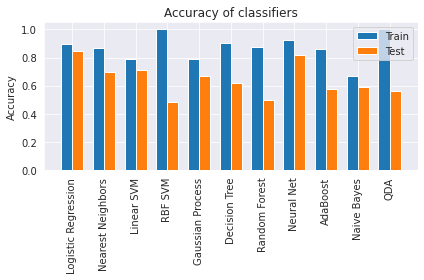

In [ ]:
x = np.arange(len(names))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, scores_train, width, label='Train')
rects2 = ax.bar(x + width/2, scores_test, width, label='Test')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Accuracy')
ax.set_title('Accuracy of classifiers')
ax.set_xticks(x)
plt.xticks(rotation = 90)
ax.set_xticklabels(names)
ax.legend()

fig.tight_layout()

plt.show()

## Building and fitting Convolutional Neural Network
### Required libraries import

In [ ]:
! pip install tensorflow
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout 
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
import tensorflow as tf
from sklearn.metrics import classification_report,confusion_matrix

     |████████████████████████████████| 462 kB 24.1 MB/s 


### Data preprocessing and data augmentation

In [ ]:
x_train = []
y_train = []
x_val = []
y_val = []

for feature, label in train:
    x_train.append(feature)
    y_train.append(label)

for feature, label in val:
    x_val.append(feature)
    y_val.append(label)

# Normalize the data
x_train = np.array(x_train) / 255
x_val = np.array(x_val) / 255

# Reshaping input images
x_train = x_train.reshape(-1, IMM_SIZE, IMM_SIZE, 1)
x_val = x_val.reshape(-1, IMM_SIZE, IMM_SIZE, 1)

# Creating a dictionary of clases
lab = {}
for i, l in enumerate(set(y_train)):
    lab[l] = i


y_train = np.array([lab[l] for l in y_train])
y_val = np.array([lab[l] for l in y_val])

In [ ]:
print("Shape of the input DataSet:", x_train.shape)
print("Shape of the output DataSet:", y_train.shape)
print("Dictionary of classes:", lab)

Shape of the input DataSet: (251, 224, 224, 1)
Shape of the output DataSet: (251,)
Dictionary of classes: {'Normal': 0, 'Covid': 1, 'Viral Pneumonia': 2}


### Data augmentation on the training data

In [ ]:
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.2, # Randomly zoom image 
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip = True,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(x_train)

### Model defining

In [ ]:
model = Sequential()
model.add(Conv2D(32,1,padding="same", activation="relu", input_shape=(IMM_SIZE,IMM_SIZE,1)))
model.add(MaxPool2D())

model.add(Conv2D(32, 1, padding="same", activation="relu"))
model.add(MaxPool2D())

model.add(Conv2D(64, 1, padding="same", activation="relu"))
model.add(MaxPool2D())
model.add(Dropout(0.4))

model.add(Flatten())
model.add(Dense(128,activation="relu"))
model.add(Dense(3, activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      64        
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 32)      1056      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 56, 56, 64)        2112      
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 28, 28, 64)       0

Let’s compile the model now using Adam as our optimizer and SparseCategoricalCrossentropy as the loss function. We are using a lower learning rate of 0.000001 for a smoother curve.

In [ ]:
opt = Adam(lr=0.000001)
model.compile(optimizer = opt , loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True) , metrics = ['accuracy'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Now, let’s train our model for 3000 epochs. Admittedly, the fitting process is very slow. Therefore, we saved the fitted model to a file. To save time, we will upload the fitted model.


In [ ]:
fitting = True
fitting_save = True
epochs = 3000

import pickle

if fitting:
    history = model.fit(x_train,y_train,epochs = epochs , validation_data = (x_val, y_val), shuffle = True)
    if fitting_save:
    # serialize model to JSON
        model_json = model.to_json()
        with open("model.json", "w") as json_file:
            json_file.write(model_json)
        # serialize weights to HDF5
        model.save_weights("model.h5")
        print("Saved model to disk")
        with open('history.pickle', 'wb') as f:
            pickle.dump(history.history, f)
        with open('lab.pickle', 'wb') as f:
            pickle.dump(lab, f)
# load model  
from keras.models import model_from_json
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
# load weights into a new model
model.load_weights("model.h5")        
with open('history.pickle', 'rb') as f:
    history = pickle.load(f)
print("Loaded model from disk")

Epoch 1/3000


/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


Streaming output truncated to the last 5000 lines.
Epoch 502/3000
8/8 [==============================] - 6s 787ms/step - loss: 0.3247 - accuracy: 0.9163 - val_loss: 0.5415 - val_accuracy: 0.8182
Epoch 503/3000
8/8 [==============================] - 6s 789ms/step - loss: 0.3265 - accuracy: 0.9044 - val_loss: 0.5413 - val_accuracy: 0.8182
Epoch 504/3000
8/8 [==============================] - 6s 789ms/step - loss: 0.3210 - accuracy: 0.9203 - val_loss: 0.5409 - val_accuracy: 0.8182
Epoch 505/3000
8/8 [==============================] - 6s 786ms/step - loss: 0.3198 - accuracy: 0.9163 - val_loss: 0.5405 - val_accuracy: 0.8182
Epoch 506/3000
8/8 [==============================] - 6s 791ms/step - loss: 0.3183 - accuracy: 0.9163 - val_loss: 0.5402 - val_accuracy: 0.8182
Epoch 507/3000
8/8 [==============================] - 6s 789ms/step - loss: 0.3215 - accuracy: 0.9084 - val_loss: 0.5398 - val_accuracy: 0.8182
Epoch 508/3000
8/8 [==============================] - 6s 792ms/step - loss: 0.3177 - 

### Results evaluation

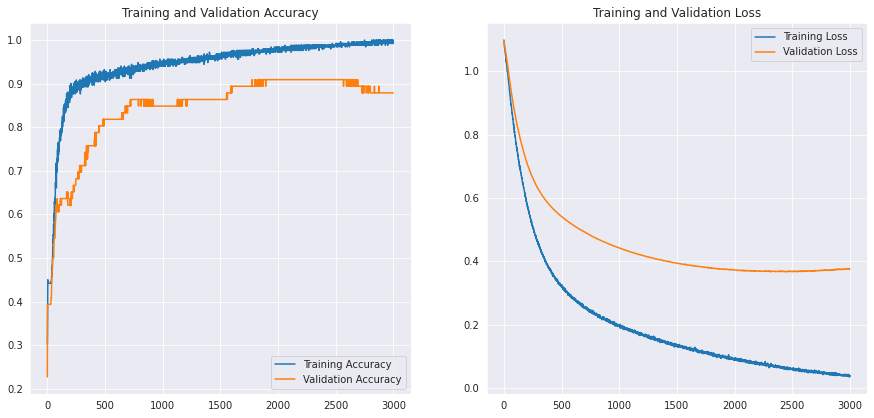

In [ ]:
acc = history['accuracy']
val_acc = history['val_accuracy']
loss = history['loss']
val_loss = history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(15, 15))
plt.subplot(2, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()